In [1]:
import spikeinterface.extractors as se
import matplotlib.pyplot as plt
from os import listdir
from os.path import isfile, isdir, join,abspath
import os
import pandas as pd
import numpy as np
from scipy.fft import fft, fftfreq

In [2]:
chans = 1
Data = []
rows = []
for filename in listdir("./stndata"):
    fullpath = join("./stndata",filename)
    filename=os.path.splitext(filename)[0]    #33_-0.200_SNr.smrx to 33_-0.200_SNr
    [person,depth,region] =filename.split("_")
    sedata=[]
    for i in range (chans):   
        recording=se.read_ced(fullpath,str(i))
        seq=  recording.get_traces(return_scaled=False)
        #seq1=seq[10000+samples*(j+1):10000+samples*(j+1)+samples]
        #scaler = preprocessing.MinMaxScaler().fit(seq1)
        #scaled1 = scaler.transform(seq1)
        sedata.append(seq.flatten())
    Data.append(sedata)    
    rows.append({'Person': person,'Depth': depth,'Region': region, 'Seq':seq.flatten()})

dataframe = pd.DataFrame(rows)    

In [3]:
dataframe

,Person,Depth,Region,Seq
0,01,+0.683,SNr,"[-16, -14, -6, -32, 18, 10, 40, 4, 56, 16, 22,..."
1,01,-0.031,SNr,"[-56, 7, 5, 40, 83, 9, 47, 130, 75, 75, 5, 91,..."
2,01,-0.271,STN lower border,"[79, 83, 176, -162, 168, 156, 94, 53, 29, 9, 4..."
3,01,-0.963,ventral STN,"[9, -67, 42, 49, 65, 77, 53, 70, 9, 28, 56, 11..."
4,01,-10.242,thalamus retiular cell,"[87, 26, 58, -19, 83, 65, 86, 86, 14, 193, -20..."
...,...,...,...,...
428,40,-4.419,dorsal STN,"[227, -36, -56, -133, -6, -116, -105, 135, 174..."
429,40,-5.091-1,dorsal STN,"[-265, 12, 91, -174, -91, 157, -94, 61, 31, -1..."
430,40,-5.091-2,dorsal STN,"[93, -55, 75, -102, -17, -41, -48, -106, -182,..."
431,40,-5.091,STN upper border,"[57, -31, -95, 173, -7, 53, 12, 53, -1, -11, 2..."


In [4]:
dataframe.groupby('Person').size()

Person
01    22
03    23
04    20
06    20
07    18
11    20
16    18
17    23
21    12
22    21
23    14
24    20
26    19
28    17
29    20
30    17
31    17
32    24
33    22
34    15
35    14
39    20
40    17
dtype: int64

In [5]:
dataframe.groupby('Region').size()

Region
SNr                             41
SNr, tip location                1
STN lower border                 6
STN upper border                23
ZI                              22
ZI (out of STN)                  1
dorsal                           2
dorsal STN                     259
dorsal STN                       5
dorsal STN-1                     1
out of STN                       2
thalamus                        10
thalamus retiular cell           1
thalamus, reticular cell         1
thalamus, silent background      1
ventral  STN                     1
ventral STN                     55
ventral STN (two cells)          1
dtype: int64

In [6]:
Data[0][0]

array([-16, -14,  -6, ...,  64,  36,  44], dtype=int16)

In [7]:
files = listdir('./stndata')

In [8]:
len(files)

433

In [9]:
fignum=40
fig, axs = plt.subplots(fignum,dpi= 300, sharex=True,figsize=(30,100))
for i in range(fignum):
    axs[i].plot(Data[i][0][0:180000])
    axs[i].set_title(files[i])
plt.subplots_adjust(hspace=1.5)
plt.show()


In [10]:
def plotstn(tester,samples):
    fignum=len(files)
    point=np.zeros(fignum)
    num=0
    for i in range(fignum):
        filename=os.path.splitext(files[i])[0]  
        [person,depth,region] =filename.split("_")
        if (person==tester):
            point[i]=1
            num+=1
    fig, axs = plt.subplots(num,dpi= 300, sharex=True,figsize=(20,30))  
    pic=0
    for i in range(fignum):   
        if(point[i]):
            axs[pic].plot(Data[i][0][0:samples])
            axs[pic].set_title(files[i])
            pic+=1
    plt.subplots_adjust(hspace=1)
    plt.show()


In [11]:
def plotstnftt(tester,samples):
    SAMPLE_RATE=24000
    fignum=len(files)
    point=np.zeros(fignum)
    num=0
    for i in range(fignum):
        filename=os.path.splitext(files[i])[0]  
        [person,depth,region] =filename.split("_")
        if (person==tester):
            point[i]=1
            num+=1
    fig, axs = plt.subplots(num,dpi= 300, sharex=True,figsize=(10,17))  
    pic=0
    for i in range(fignum):   
        if(point[i]):
            axs[pic].plot(fftfreq(samples, 1 / SAMPLE_RATE),np.abs(fft(Data[i][0][0:samples])))
            #axs[pic].plot(Data[i][0][0:samples])
            axs[pic].set_title(files[i])
            pic+=1
    plt.subplots_adjust(hspace=1)
    plt.show()


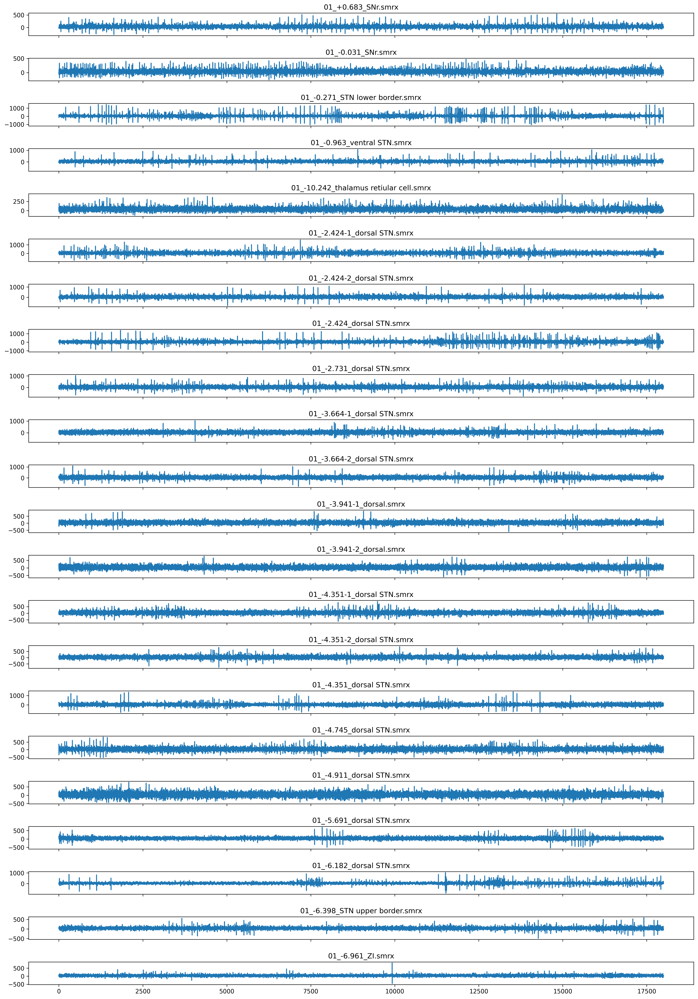

In [12]:
plotstn('01',18000)

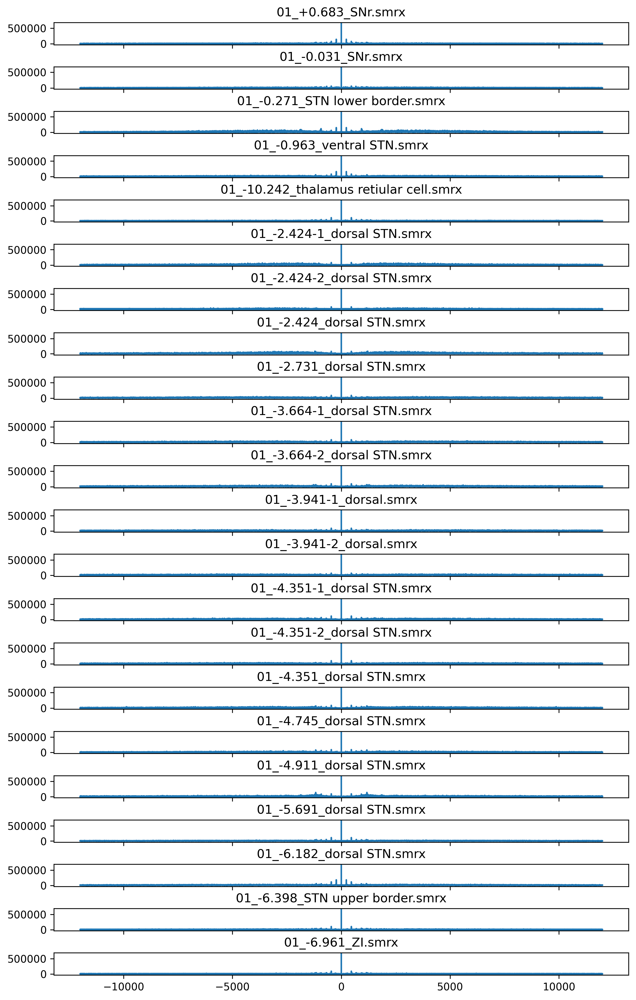

In [13]:
plotstnftt('01',18000)

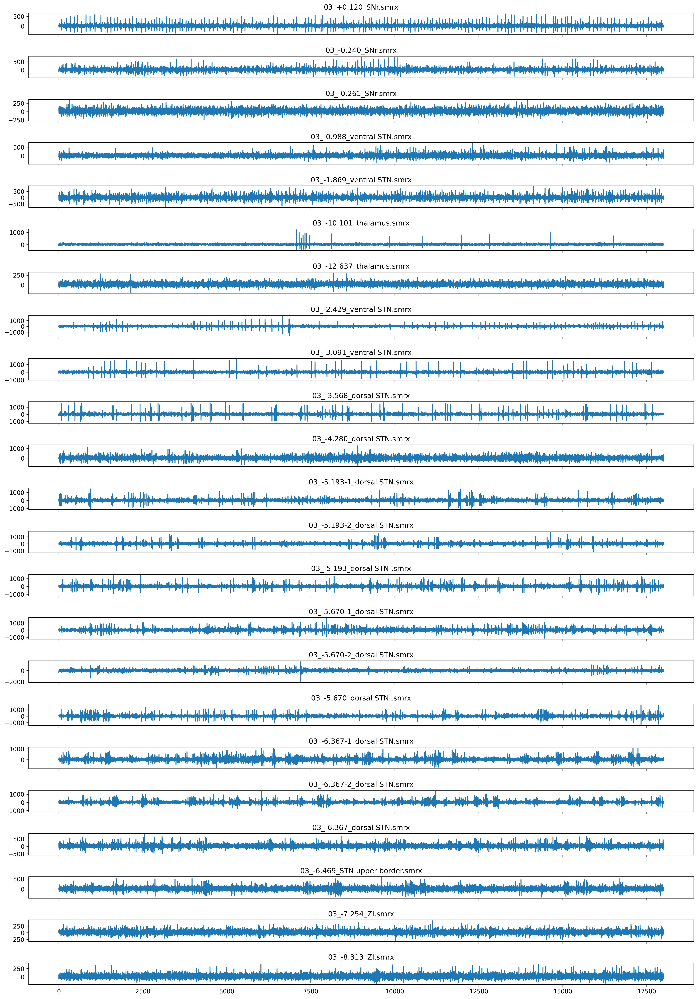

In [14]:
plotstn('03',18000)

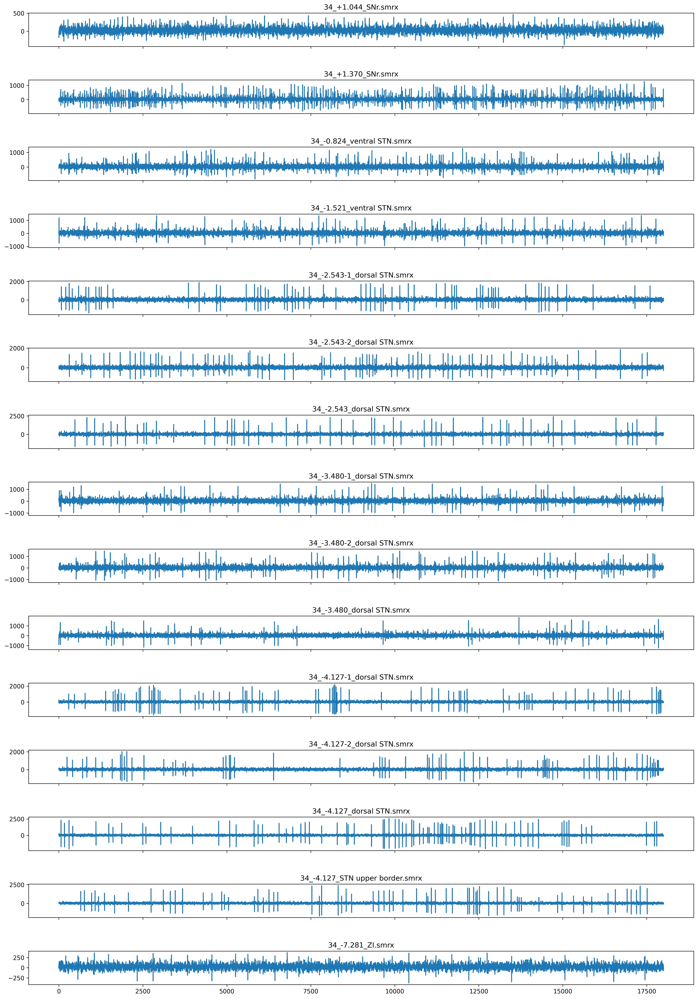

In [15]:
plotstn('34',18000)

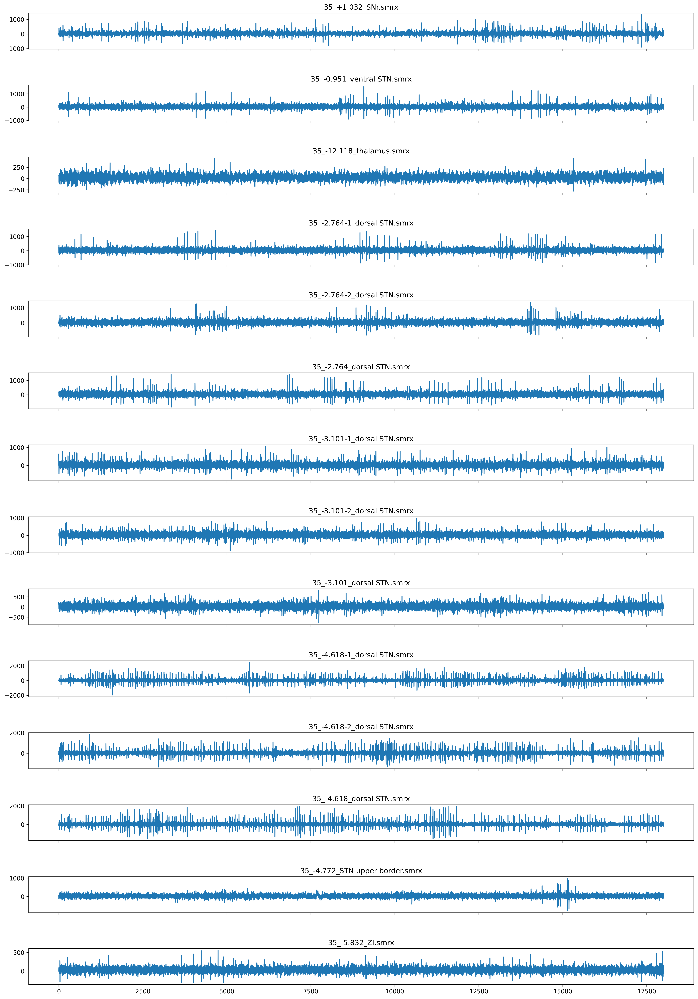

In [16]:
plotstn('35',18000)

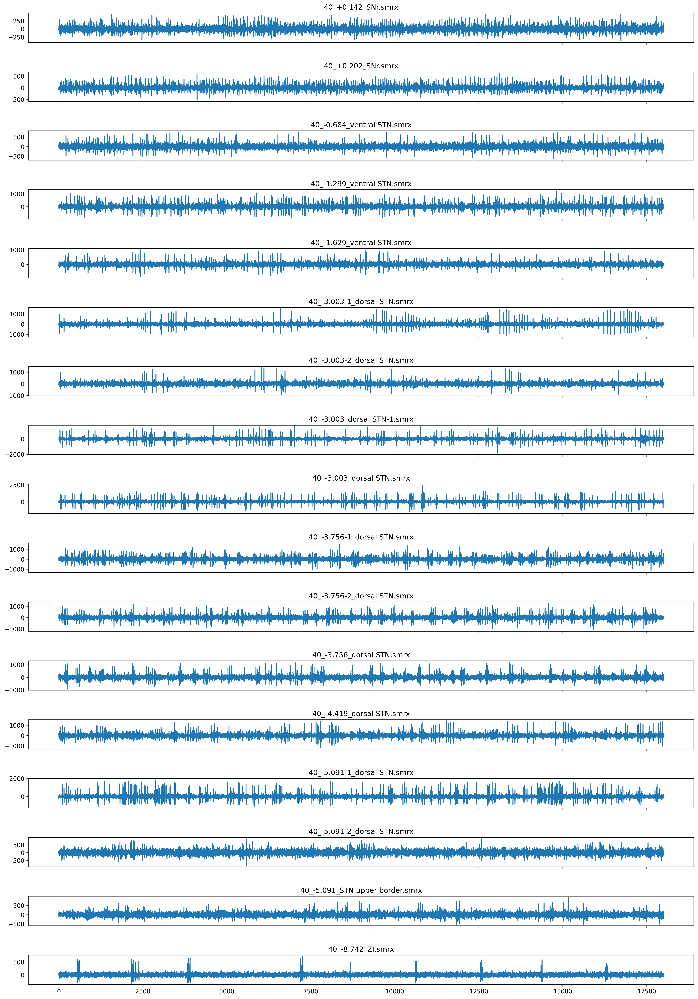

In [17]:
plotstn('40',18000)

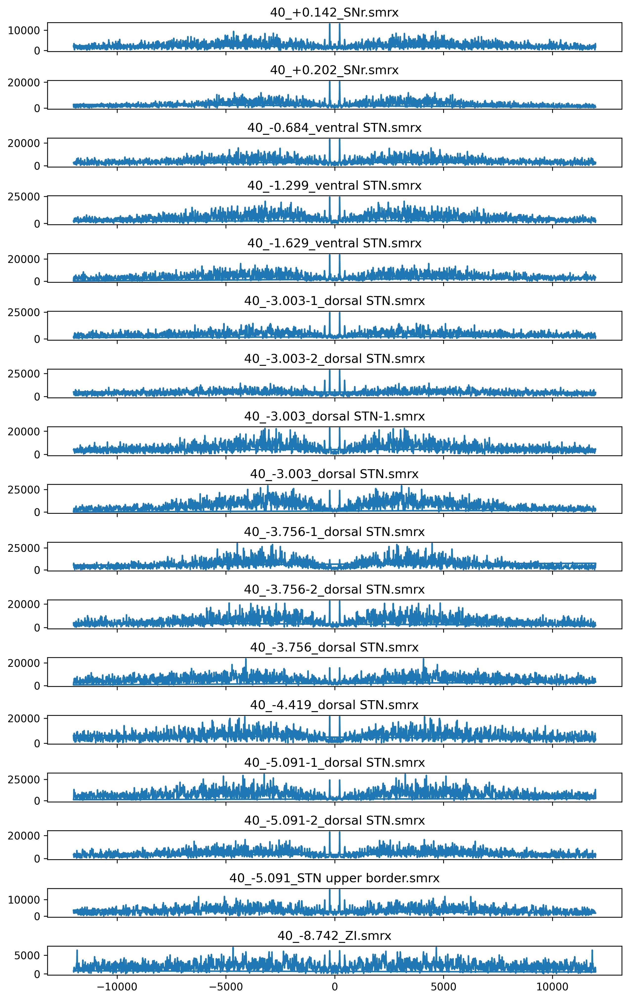

In [18]:
plotstnftt('40',2000)

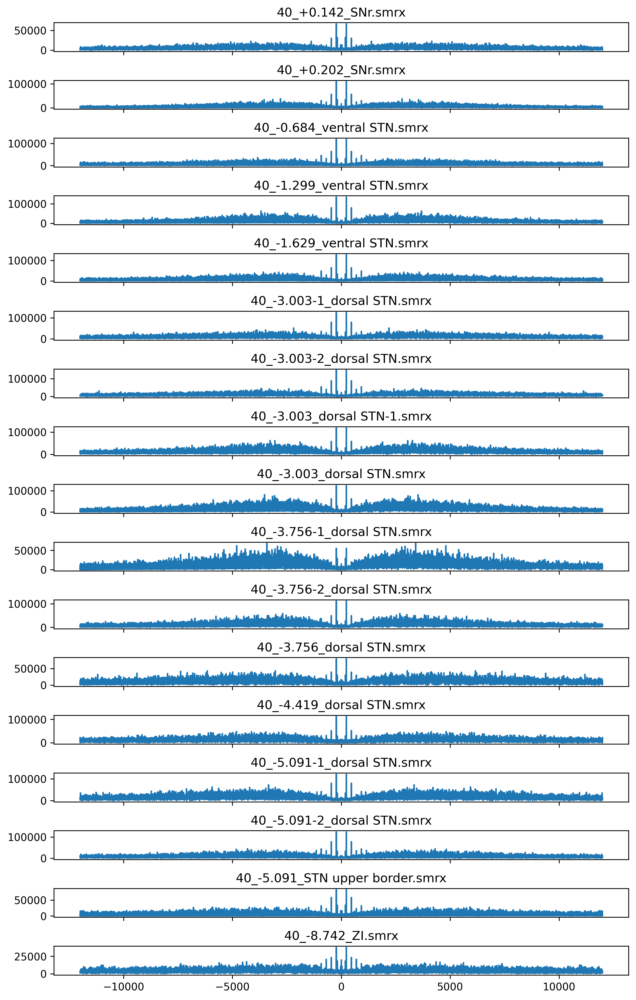

In [19]:
plotstnftt('40',10000)

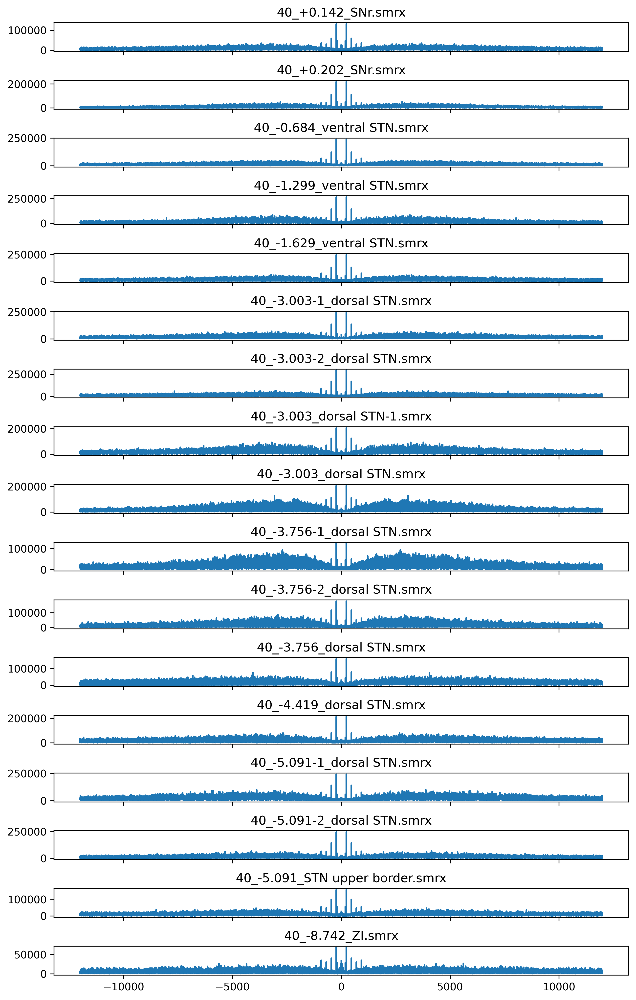

In [20]:
plotstnftt('40',20000)

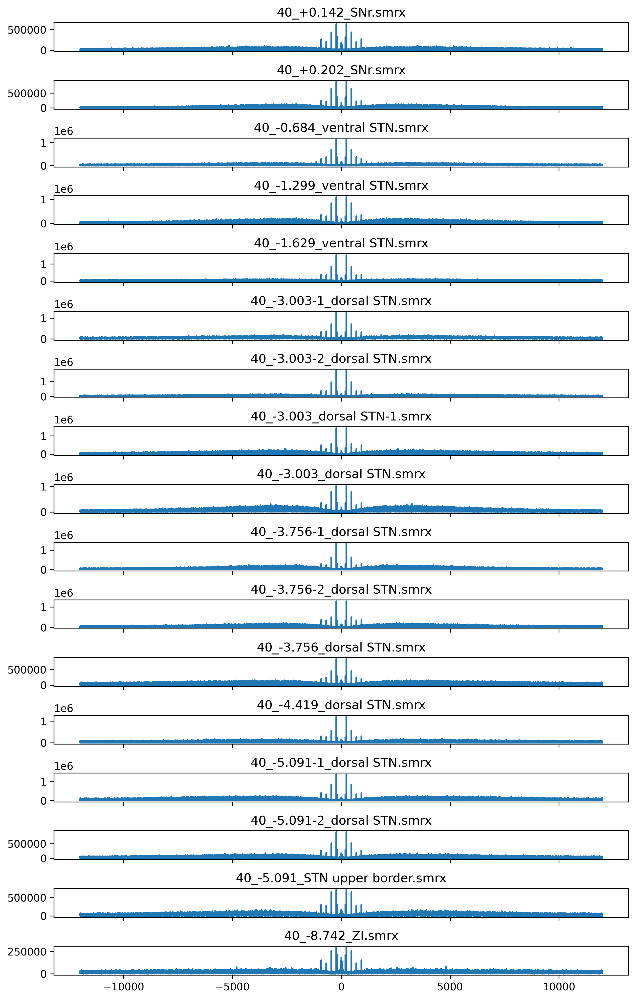

In [21]:
plotstnftt('40',120000)